here we go through evaluations and gather results to be displayed nicely

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pickle
import numpy as np
import tensorflow as tf
import cv2
from scipy import misc
import math
import time
import matplotlib.pyplot as plt
%matplotlib inline

import sys
sys.path.append("../")
from data.occnet_data_loader import OccnetTfrecordLoader
from network.main import Transformer, predict, _default_hparams, relative_pose_loss
from network import utils
from data.don_data_loader import DonDataLoader

In [3]:
%%capture

# some important variables
NUM_KP = 10
# EXPERIMENT = "19-04-12_01-53-40" #without occlusion augmentations
EXPERIMENT = "19-05-12_11-42-54" #with occlusion augmentations

# create the classes we care about
data_loader = DonDataLoader()

# get the network we want to run evaluations with
uvz, sess, img = predict(None, None, only_uvz_sess_img=True, num_kp=NUM_KP, model_dir="../experiments/{}/".format(EXPERIMENT), latest_filename=None)
def get_uvz_from_rgb_image(image):
    orig = image.copy().astype(float) / 255.0
    orig = np.concatenate((orig, np.ones_like(orig[:, :, :1])), axis=2)
    uv_ret = sess.run(uvz, feed_dict={img: np.expand_dims(orig, 0)})
    return uv_ret
    

Instructions for updating:
tf.py_func is deprecated in TF V2. Instead, use
    tf.py_function, which takes a python function which manipulates tf eager
    tensors instead of numpy arrays. It's easy to convert a tf eager tensor to
    an ndarray (just call tensor.numpy()) but having access to eager tensors
    means `tf.py_function`s can use accelerators such as GPUs as well as
    being differentiable using a gradient tape.
    
Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Use standard file APIs to check for files with this prefix.
INFO:tensorflow:Restoring parameters from ../experiments/19-05-12_11-42-54/model.ckpt-200000


In [4]:
cols = plt.cm.get_cmap("rainbow")(
      np.linspace(0, 1.0, NUM_KP))[:, :4]
def draw_points(image, uv_ret):
    # note that this all operates on normalized coordinates
    orig = image.copy().astype(float) / 255.0
    orig = np.concatenate((orig, np.ones_like(orig[:, :, :1])), axis=2)
    utils.draw_ndc_points(orig, uv_ret.reshape(NUM_KP, 3), cols)
    return orig

In [5]:
# inference runtime per image (sec)
example_image = np.zeros((128, 128, 3))
uv_ret = get_uvz_from_rgb_image(example_image)
start = time.time()
RUNTIME_ITERATIONS = 10
for i in range(RUNTIME_ITERATIONS):
    uv_ret = get_uvz_from_rgb_image(example_image)
end = time.time()
print("inference runtime per image (sec):", (end - start) / RUNTIME_ITERATIONS)

inference runtime per image (sec): 0.004295611381530761


In [6]:
def get_output_images(SCENE_NAME):

    # the frames in order for the particular scene
    frames = sorted(list(data_loader.dataset.get_pose_data(SCENE_NAME).keys()))

    # load all the images into this array
    images = []
    rgb_images = []
    masks = []
    for i in range(len(frames)):
        frame_idx = frames[i]
        rgb_a, _, mask_a, _ = data_loader.dataset.get_rgbd_mask_pose(SCENE_NAME, frame_idx)
        rgb = np.array(rgb_a)
        mask = np.repeat(np.expand_dims(np.array(mask_a), axis=2), 3, axis=2)
        image = rgb * np.repeat(np.expand_dims(np.array(mask_a), axis=2), 3, axis=2)
        image = cv2.resize(image, (128, 128))
        # add the images we use to the arrays
        images.append(image)
        rgb_images.append(cv2.resize(rgb, (128, 128)))
        masks.append(cv2.resize(mask, (128, 128)))
        
    # go through images and run inference
    output_images = []
    for i in range(len(images)):
        # get keypoints and draw them
        uv_ret = get_uvz_from_rgb_image(images[i])
        output_image = draw_points(images[i], uv_ret)
        # optionally add original image back in
        output_image[:,:,:3] = rgb_images[i]*(1.0 - masks[i]).astype(float) / 255.0 + output_image[:,:,:3] 
        output_images.append(output_image)
        
    return output_images

In [7]:
scene_names = []
output_images_list = []
SCENE_NAME_LIST = ["2018-05-14-22-10-53", 
                   "2018-05-14-22-57-40", 
                   "2018-05-09-18-19-27", 
                   "2018-05-15-00-04-06", 
                   "2018-05-15-00-26-19", 
                   "2018-05-15-00-06-46"]

for i in range(6):
    
    SCENE_NAME = SCENE_NAME_LIST[i]

#     SCENE_NAME = None # "2018-05-09-18-35-42"
#     if SCENE_NAME is None:
#         SCENE_NAME = data_loader.get_random_scene_from_object_id()
    
    output_images = get_output_images(SCENE_NAME)
    
    scene_names.append(SCENE_NAME)
    output_images_list.append(output_images)

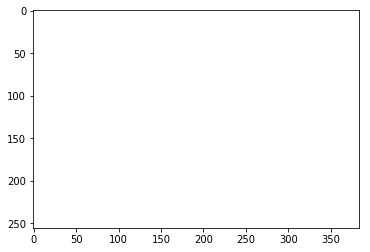

In [8]:
# draw in a pretty way
import matplotlib.animation as animation

fig = plt.figure()

ims = []
for i in range(min([len(j) for j in output_images_list])):
    combine_list = [k[i] for k in output_images_list]
    combined_image_top = np.hstack(combine_list[:3])
    combined_image_bot = np.hstack(combine_list[3:])
    combined_image = np.vstack([combined_image_top, combined_image_bot])
    im = plt.imshow(combined_image, animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

# ani.save('{}_{}.mp4'.format(EXPERIMENT, SCENE_NAME))
# plt.show()

In [9]:
ani.save('{}_{}.mp4'.format(EXPERIMENT, str(SCENE_NAME_LIST).replace(", ", "_").replace("'", "")))

In [10]:
from IPython.display import HTML
HTML(ani.to_jshtml())

In [11]:
# computing pose estimation metrics
# - either read from scene or from tfrecords

record_session = tf.Session()

DATASET_NAME = "400"
dataloader = OccnetTfrecordLoader("../datasets/{}/".format(DATASET_NAME), occnet_data=True)
occnet_transformer = Transformer(128, 128, "../datasets/{}/".format(DATASET_NAME), occnet=True)
features = dataloader.get_features()

# modify features so it's easy to grab from
def func1(x):
    return tf.transpose(tf.reshape(features[x], [-1, 4, 4]), [0, 2, 1])

mv = [func1("mv%d" % i) for i in range(2)]
mvi = [func1("mvi%d" % i) for i in range(2)]
images = [features["img0_png"][0, :, :, :3], features["img1_png"][0, :, :, :3]]
rot = tf.matmul(mvi[0], mv[1])

Instructions for updating:
Deprecated in favor of operator or tf.math.divide.


In [12]:
NUM_EVALUATION = 1
total_angular = 0.0 
for i in range(NUM_EVALUATION):

    np_images, np_rot = record_session.run([images, rot])

    uvz0 = get_uvz_from_rgb_image(np_images[0])
    uvz1 = get_uvz_from_rgb_image(np_images[1])

    # convert the keypoint to tensor
    tf_uvz = [tf.convert_to_tensor(uvz0), tf.convert_to_tensor(uvz1)]
    # convert rot back to tensor
    tf_rot = tf.convert_to_tensor(np_rot)
    
    # batch size of 1
    pconf = tf.ones([1, NUM_KP], dtype=tf.float32) / NUM_KP
    noise = 0.01 # ethan: change this / figure this out
    chordal, angular = relative_pose_loss(
        occnet_transformer.unproject(tf_uvz[0])[:, :, :3],
        occnet_transformer.unproject(tf_uvz[1])[:, :, :3],
        tf_rot,
        pconf,
        noise
    )
    
    np_angular = record_session.run(angular)
    
    total_angular += np_angular
    
average_angular = total_angular / NUM_EVALUATION

print("average_angular: {}".format(average_angular))

average_angular: 0.1026003286242485
